# Third Project: Recommender System - MovieLens 1M

Team members:
- Harry Bhasin
- Oscar Padilla

In [54]:
%load_ext watermark
%watermark -u -d -v -p numpy,pandas,matplotlib,sklearn

last updated: 2017-08-10 

CPython 2.7.12
IPython 5.4.1

numpy 1.11.1
pandas 0.18.1
matplotlib 1.5.3
sklearn 0.18.1


## TOC

- [Background](#0.-Background)

- [Load Data & Libraries](#1.-Load-Data-&-Libraries)

- [Exploratory Data Analysis](#2.-EDA)

- [Model Building](#3.-Model-Building)
    - [User-Item](#3.1-User-Item)
    - [Item-Item](#3.2-Item-Item)
    - [Popularity](#3.3-Popularity)
    
- [Evaluation](#4.-Evaluation)
    - [Item-Item](#4.1-Item-Item)
    - [User-Item](#4.2-User-Item)
    - [Popularity](#4.3-Popularity)
    - [Tuned Parameters](#4.4-Tuned-Parameters)
    - [Grid Search](#4.5-Grid-Search)
    
- [Deployment](#5.-Deployment)

- [References](#6.-References)

# 0. Background

http://grouplens.org/datasets/movielens/1m/

MovieLens collects the movie rating data through their website and, GroupLens, a research department at the University of Minnesota does further research on this collected data. For our recommender project we decided to use this data as it fits very well in recommending movies using collaborative filtering. This data set consists of the following:

* Over a million ratings from 6040 users on 3952 movies. 
* Each user has rated at least 20 movies.

Description of 

### users.dat
6040 users. Four fields: user id, gender, age, occupation, zip
Occupation code is as follows,
    *  0:  "other" or not specified
	*  1:  "academic/educator"
	*  2:  "artist"
	*  3:  "clerical/admin"
	*  4:  "college/grad student"
	*  5:  "customer service"
	*  6:  "doctor/health care"
	*  7:  "executive/managerial"
	*  8:  "farmer"
	*  9:  "homemaker"
	* 10:  "K-12 student"
	* 11:  "lawyer"
	* 12:  "programmer"
	* 13:  "retired"
	* 14:  "sales/marketing"
	* 15:  "scientist"
	* 16:  "self-employed"
	* 17:  "technician/engineer"
	* 18:  "tradesman/craftsman"
	* 19:  "unemployed"
	* 20:  "writer"

### movies.dat
3952 movies. Titles are identical to titles provided by the IMDB (including year of release). Genres are pipe-separated and are selected from the following genres:

	* Action
	* Adventure
	* Animation
	* Children's
	* Comedy
	* Crime
	* Documentary
	* Drama
	* Fantasy
	* Film-Noir
	* Horror
	* Musical
	* Mystery
	* Romance
	* Sci-Fi
	* Thriller
	* War
	* Western

### ratings.dat
1,000,209 anonymous ratings
	* UserIDs range between 1 and 6040 
	* MovieIDs range between 1 and 3952
	* Ratings are made on a 5-star scale (whole-star ratings only)
	* Timestamp is represented in seconds since the epoch as returned by time
	* Each user has at least 20 ratings

### Evaluation Method

Cross validation will be performed using the following evaluation criteria:

- **RMSE**

Root mean squared error takes into account the difference between the predicted rating and the actual rating of items. RMSE will be calculated by user and by item

- **Precision**

(also called positive predictive value) is the fraction of relevant instances among the retrieved instances

- **Recall**

(also known as sensitivity) is the fraction of relevant instances that have been retrieved over the total amount of relevant instances

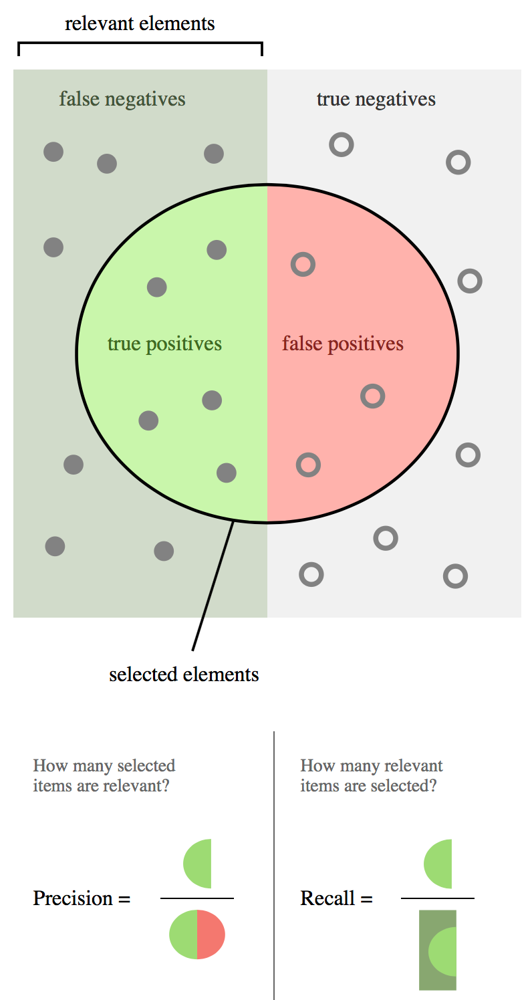

In [159]:
# from Wikipedia

from IPython.display import Image
Image("PrecisionRecall.png")

[Back to Top](#TOC)

# 1. Load Data & Libraries

Import 1m MovieLens dataset as Panda DataFrame

In [104]:
import pandas as pd
import numpy as np

path = '/Users/GS7271/Documents/MSDS7331/Project3/ml-1m/'

unames = ['user_id', 'gender', 'age', 'occupation', 'zip']
users = pd.read_table(path + 'users.dat', sep = '::', header = None, names = unames, engine='python')

rnames = ['user_id', 'movie_id', 'rating', 'timestamp']
ratings = pd.read_table(path + 'ratings.dat', sep = '::', header = None, names = rnames, engine='python')

mnames = ['movie_id', 'title', 'genres']
movies = pd.read_table(path + 'movies.dat', sep = '::', header = None, names = mnames, engine='python')

print(users.shape)
print(ratings.shape)
print(movies.shape)

(6040, 5)
(1000209, 4)
(3883, 3)


In [105]:
movies.head()

,movie_id,title,genres
0,1,Toy Story (1995),Animation|Children's|Comedy
1,2,Jumanji (1995),Adventure|Children's|Fantasy
2,3,Grumpier Old Men (1995),Comedy|Romance
3,4,Waiting to Exhale (1995),Comedy|Drama
4,5,Father of the Bride Part II (1995),Comedy


Merging *movies, users* and *ratings* (on overlapping names: user_id, movie_id)

In [106]:
data = pd.merge(pd.merge(ratings, users), movies)
data.tail()

,user_id,movie_id,rating,timestamp,gender,age,occupation,zip,title,genres
1000204,5949,2198,5,958846401,M,18,17,47901,Modulations (1998),Documentary
1000205,5675,2703,3,976029116,M,35,14,30030,Broken Vessels (1998),Drama
1000206,5780,2845,1,958153068,M,18,17,92886,White Boys (1999),Drama
1000207,5851,3607,5,957756608,F,18,20,55410,One Little Indian (1973),Comedy|Drama|Western
1000208,5938,2909,4,957273353,M,25,1,35401,"Five Wives, Three Secretaries and Me (1998)",Documentary


In [53]:
data.dtypes

user_id        int64
movie_id       int64
rating         int64
timestamp      int64
gender        object
age            int64
occupation     int64
zip           object
title         object
genres        object
dtype: object

[Back to Top](#TOC)

# 2. EDA

*Based on Python for Data Analysis*

Contents of a specific row

In [86]:
data.ix[1000207]

user_id                           5851
movie_id                          3607
rating                               5
timestamp                    957756608
gender                               F
age                                 18
occupation                          20
zip                              55410
title         One Little Indian (1973)
genres            Comedy|Drama|Western
Name: 1000207, dtype: object

pivot_table function on a DataFrame will construct a movie / gender rating matrix

In [87]:
mean_ratings = data.pivot_table(index = ['title'], columns = ['gender'], values = 'rating', aggfunc = 'mean')
mean_ratings[:10]

gender,F,M
title,,
"$1,000,000 Duck (1971)",3.375000,2.761905
'Night Mother (1986),3.388889,3.352941
'Til There Was You (1997),2.675676,2.733333
"'burbs, The (1989)",2.793478,2.962085
...And Justice for All (1979),3.828571,3.689024
1-900 (1994),2.000000,3.000000
10 Things I Hate About You (1999),3.646552,3.311966
101 Dalmatians (1961),3.791444,3.500000
101 Dalmatians (1996),3.240000,2.911215


In [88]:
ratings_by_title = data.groupby('title').size()
ratings_by_title.head(10)

title
$1,000,000 Duck (1971)                37
'Night Mother (1986)                  70
'Til There Was You (1997)             52
'burbs, The (1989)                   303
...And Justice for All (1979)        199
1-900 (1994)                           2
10 Things I Hate About You (1999)    700
101 Dalmatians (1961)                565
101 Dalmatians (1996)                364
12 Angry Men (1957)                  616
dtype: int64

Filter movies with at least *n* ratings

In [89]:
n = 250
active_titles = ratings_by_title.index[ratings_by_title >= n]
active_titles

Index([u''burbs, The (1989)', u'10 Things I Hate About You (1999)',
       u'101 Dalmatians (1961)', u'101 Dalmatians (1996)',
       u'12 Angry Men (1957)', u'13th Warrior, The (1999)',
       u'2 Days in the Valley (1996)', u'20,000 Leagues Under the Sea (1954)',
       u'2001: A Space Odyssey (1968)', u'2010 (1984)',
       ...
       u'X-Men (2000)', u'Year of Living Dangerously (1982)',
       u'Yellow Submarine (1968)', u'You've Got Mail (1998)',
       u'Young Frankenstein (1974)', u'Young Guns (1988)',
       u'Young Guns II (1990)', u'Young Sherlock Holmes (1985)',
       u'Zero Effect (1998)', u'eXistenZ (1999)'],
      dtype='object', name=u'title', length=1216)

Now we select only active titles from the pivot table created above

In [90]:
mean_ratings = mean_ratings.ix[active_titles]
mean_ratings[:10]

gender,F,M
title,,
"'burbs, The (1989)",2.793478,2.962085
10 Things I Hate About You (1999),3.646552,3.311966
101 Dalmatians (1961),3.791444,3.500000
101 Dalmatians (1996),3.240000,2.911215
12 Angry Men (1957),4.184397,4.328421
"13th Warrior, The (1999)",3.112000,3.168000
2 Days in the Valley (1996),3.488889,3.244813
"20,000 Leagues Under the Sea (1954)",3.670103,3.709205
2001: A Space Odyssey (1968),3.825581,4.129738


Top movies for female viewers

In [91]:
top_female_ratings = mean_ratings.sort_values(by = 'F', ascending = False)
top_female_ratings[:10]

gender,F,M
title,,
"Close Shave, A (1995)",4.644444,4.473795
"Wrong Trousers, The (1993)",4.588235,4.478261
Sunset Blvd. (a.k.a. Sunset Boulevard) (1950),4.572650,4.464589
Wallace & Gromit: The Best of Aardman Animation (1996),4.563107,4.385075
Schindler's List (1993),4.562602,4.491415
"Shawshank Redemption, The (1994)",4.539075,4.560625
"Grand Day Out, A (1992)",4.537879,4.293255
To Kill a Mockingbird (1962),4.536667,4.372611
Creature Comforts (1990),4.513889,4.272277


Ratings difference male vs. female: movies preferred by women

In [92]:
mean_ratings['diff'] = mean_ratings['M'] - mean_ratings['F']
sorted_by_diff = mean_ratings.sort_values(by = 'diff')
sorted_by_diff[:15]

gender,F,M,diff
title,,,
Dirty Dancing (1987),3.790378,2.959596,-0.830782
Jumpin' Jack Flash (1986),3.254717,2.578358,-0.676359
Grease (1978),3.975265,3.367041,-0.608224
Little Women (1994),3.870588,3.321739,-0.548849
Steel Magnolias (1989),3.901734,3.365957,-0.535777
Anastasia (1997),3.800000,3.281609,-0.518391
"Rocky Horror Picture Show, The (1975)",3.673016,3.160131,-0.512885
"Color Purple, The (1985)",4.158192,3.659341,-0.498851
"Age of Innocence, The (1993)",3.827068,3.339506,-0.487561


Movies preferred by men

In [93]:
sorted_by_diff[::-1][:15]

gender,F,M,diff
title,,,
"Good, The Bad and The Ugly, The (1966)",3.494949,4.221300,0.726351
"Kentucky Fried Movie, The (1977)",2.878788,3.555147,0.676359
Dumb & Dumber (1994),2.697987,3.336595,0.638608
"Longest Day, The (1962)",3.411765,4.031447,0.619682
"Cable Guy, The (1996)",2.250000,2.863787,0.613787
Evil Dead II (Dead By Dawn) (1987),3.297297,3.909283,0.611985
"Hidden, The (1987)",3.137931,3.745098,0.607167
Rocky III (1982),2.361702,2.943503,0.581801
Caddyshack (1980),3.396135,3.969737,0.573602


Love it or Hate it: Movies with most disagreement among viewers (as measured per standard deviation)

In [94]:
rating_std_by_title = data.groupby('title')['rating'].std()
rating_std_by_title = rating_std_by_title.ix[active_titles]
rating_std_by_title.sort_values(ascending = False)[:10]

title
Dumb & Dumber (1994)                     1.321333
Blair Witch Project, The (1999)          1.316368
Natural Born Killers (1994)              1.307198
Tank Girl (1995)                         1.277695
Rocky Horror Picture Show, The (1975)    1.260177
Eyes Wide Shut (1999)                    1.259624
Evita (1996)                             1.253631
Billy Madison (1995)                     1.249970
Fear and Loathing in Las Vegas (1998)    1.246408
Bicentennial Man (1999)                  1.245533
Name: rating, dtype: float64

Distribution of ratings: histogram

(array([  56174.,  107557.,  261197.,  575281.]),
 array([1, 2, 3, 4, 5]),
 <a list of 4 Patch objects>)

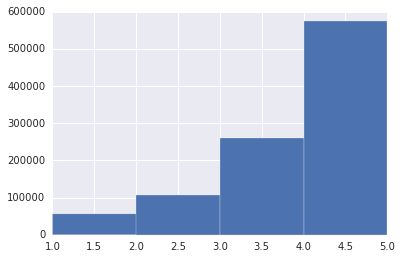

In [95]:
%matplotlib inline

import matplotlib.pyplot as plt

plt.hist(ratings.rating, bins = [1, 2, 3, 4, 5])

Distribution of ratings by age histogram

(array([  27211.,       0.,       0.,  183536.,  395556.,       0.,
         199003.,       0.,  156123.,   38780.]),
 array([  1. ,   6.5,  12. ,  17.5,  23. ,  28.5,  34. ,  39.5,  45. ,
         50.5,  56. ]),
 <a list of 10 Patch objects>)

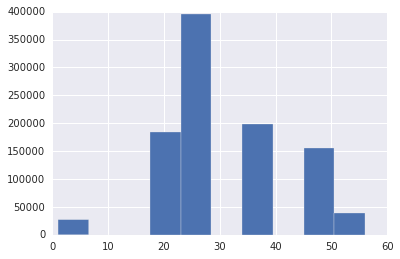

In [96]:
plt.hist(data.age)

Categorization of a numerical variable (age)

In [97]:
bins = [0, 25, 35, 45, 55, 100]
group_names = ['young', 'adult', 'mid-age', 'older', 'senior']

#categories = pd.cut(data['age'], bins, labels = group_names)
data['categories'] = pd.cut(data['age'], bins, labels = group_names)

data.head()

,user_id,movie_id,rating,timestamp,gender,age,occupation,zip,title,genres,categories
0,1,1193,5,978300760,F,1,10,48067,One Flew Over the Cuckoo's Nest (1975),Drama,young
1,2,1193,5,978298413,M,56,16,70072,One Flew Over the Cuckoo's Nest (1975),Drama,senior
2,12,1193,4,978220179,M,25,12,32793,One Flew Over the Cuckoo's Nest (1975),Drama,young
3,15,1193,4,978199279,M,25,7,22903,One Flew Over the Cuckoo's Nest (1975),Drama,young
4,17,1193,5,978158471,M,50,1,95350,One Flew Over the Cuckoo's Nest (1975),Drama,older


(array([ 215850.,   81691.,  152882.,  142630.,   14051.,   43853.,
          70968.,   72060.,  118837.,   87387.]),
 array([  0.,   2.,   4.,   6.,   8.,  10.,  12.,  14.,  16.,  18.,  20.]),
 <a list of 10 Patch objects>)

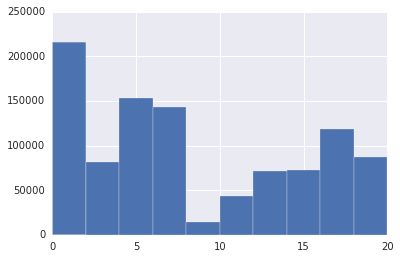

In [98]:
plt.hist(data.occupation)

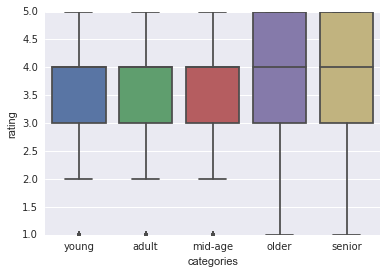

In [99]:
import seaborn as sns

ax = sns.boxplot(x = "categories", y = "rating", data = data)

GraphLab

In [100]:
from os import path
import graphlab as gl
from datetime import datetime

Convert Panda's DataFrames into GraphLab SFrames

In [101]:
items = gl.SFrame(movies)
actions = gl.SFrame(ratings)
users = gl.SFrame(users)

Importing the merged DataFrame into the GraphLab environment

In [107]:
data_gl = gl.SFrame(data)

Age Histogram

In [108]:
gl.canvas.set_target("ipynb")

data_gl.show(view = "Bar Chart", x = "Age", y=None)

Ratings Histogram

In [109]:
data_gl.show(view = "Bar Chart", x = "rating", y=None)

Rating Distribution by Age Boxplot

In [111]:
data_gl[["age", "rating"]].show(view = "BoxWhisker Plot", x = "age", y = "rating")

Rating Distribution by Gender Boxplot

In [113]:
data_gl[["gender", "rating"]].show(view = "BoxWhisker Plot", x = "gender", y = "rating")

Data preparation: elimination of rare items, e.g. ratings count <= 5

In [11]:
rare_items = actions.groupby('movie_id', gl.aggregate.COUNT).sort('Count')
rare_items = rare_items[rare_items['Count'] <= 5]
items = items.filter_by(rare_items['movie_id'], 'movie_id', exclude = True)
actions = actions.filter_by(rare_items['movie_id'], 'movie_id', exclude = True)
actions['timestamp'] = actions['timestamp'].astype(datetime)

Extracting year from movie title and parsing genres

In [12]:
items['year'] = items['title'].apply(lambda x: x[-5:-1])
items['title'] = items['title'].apply(lambda x: x[:-7])
items['genres'] = items['genres'].apply(lambda x: x.split('|'))

[Back to Top](#TOC)

# 3. Model Building

Basic Train Recommender Model

In [14]:
training_data, validation_data = gl.recommender.util.random_split_by_user(actions, 'user_id', 'movie_id')
model = gl.recommender.create(training_data, 'user_id', 'movie_id')

Recsys training: model = item_similarity

Warning: Ignoring columns rating, timestamp;

To use one of these as a target column, set target = <column_name>

and use a method that allows the use of a target.

Preparing data set.

Data has 964251 observations with 6040 users and 3377 items.

Data prepared in: 0.441962s

Training model from provided data.

Gathering per-item and per-user statistics.

+--------------------------------+------------+

| Elapsed Time (Item Statistics) | % Complete |

+--------------------------------+------------+

| 4.401ms                        | 16.5       |

| 27.212ms                       | 100        |

+--------------------------------+------------+

Setting up lookup tables.

Processing data in one pass using dense lookup tables.

+-------------------------------------+------------------+-----------------+

| Elapsed Time (Constructing Lookups) | Total % Complete | Items Processed |

+-------------------------------------+------------------+-----------------+

| 148.246ms                           | 0                | 0               |

| 886.549ms                           | 100              | 3377            |

+-------------------------------------+------------------+-----------------+

Finalizing lookup tables.

Generating candidate set for working with new users.

Finished training in 1.94232s

Interactively explore & evaluate model

In [17]:
view = model.views.overview(validation_set = validation_data,
                            user_data = users,
                            item_data = items,
                            item_name_column = 'title')
view.show()

[Back to Top](#TOC)

## 3.1 User-Item 

"5-lines recommendation model"

*Code in sections 3 and 4 is based on Data Mining Notebook # 13 Collaborative Filtering in Turi (formerly Dato, Formerly GraphLab) by Eric Larsson*

In [114]:
model = gl.recommender.create(data_gl, 
                              user_id = "user_id", 
                              item_id = "title", 
                              target = "rating")
results = model.recommend(users = None, k = 15)
model.save("user_item")

Recsys training: model = ranking_factorization_recommender

Preparing data set.

Data has 1000209 observations with 6040 users and 3706 items.

Data prepared in: 1.55031s

Training ranking_factorization_recommender for recommendations.

+--------------------------------+--------------------------------------------------+----------+

| Parameter                      | Description                                      | Value    |

+--------------------------------+--------------------------------------------------+----------+

| num_factors                    | Factor Dimension                                 | 32       |

| regularization                 | L2 Regularization on Factors                     | 1e-09    |

| solver                         | Solver used for training                         | adagrad  |

| linear_regularization          | L2 Regularization on Linear Coefficients         | 1e-09    |

| ranking_regularization         | Rank-based Regularization Weight                 | 0.25     |

| max_iterations                 | Maximum Number of Iterations                     | 25       |

+--------------------------------+--------------------------------------------------+----------+

Optimizing model using SGD; tuning step size.

Using 125026 / 1000209 points for tuning the step size.

+---------+-------------------+------------------------------------------+

| Attempt | Initial Step Size | Estimated Objective Value                |

+---------+-------------------+------------------------------------------+

| 0       | 5.55556           | Not Viable                               |

| 1       | 1.38889           | Not Viable                               |

| 2       | 0.347222          | 0.824167                                 |

| 3       | 0.173611          | 1.20798                                  |

| 4       | 0.0868056         | 0.646125                                 |

| 5       | 0.0434028         | 0.717895                                 |

| 6       | 0.0217014         | 1.085                                    |

| 7       | 0.0108507         | 1.72713                                  |

+---------+-------------------+------------------------------------------+

| Final   | 0.0868056         | 0.646125                                 |

+---------+-------------------+------------------------------------------+

Starting Optimization.

+---------+--------------+-------------------+-----------------------+-------------+

| Iter.   | Elapsed Time | Approx. Objective | Approx. Training RMSE | Step Size   |

+---------+--------------+-------------------+-----------------------+-------------+

| Initial | 103us        | 2.44693           | 1.11708               |             |

+---------+--------------+-------------------+-----------------------+-------------+

| 1       | 2.67s        | DIVERGED          | DIVERGED              | 0.0868056   |

| RESET   | 3.64s        | 2.44701           | 1.11712               |             |

| 1       | 5.87s        | 3.90663           | 1.68493               | 0.0434028   |

| 2       | 7.86s        | 3.30251           | 1.6027                | 0.0434028   |

| 3       | 9.94s        | 1.87893           | 1.24141               | 0.0434028   |

| 4       | 11.80s       | 1.45959           | 1.0962                | 0.0434028   |

| 5       | 13.55s       | 1.30216           | 1.02512               | 0.0434028   |

| 6       | 15.28s       | 1.21993           | 0.994315              | 0.0434028   |

| 7       | 16.98s       | 1.15485           | 0.970963              | 0.0434028   |

| 8       | 18.68s       | 1.10102           | 0.95379               | 0.0434028   |

| 9       | 20.48s       | 1.06195           | 0.939376              | 0.0434028   |

| 10      | 22.32s       | 1.03362           | 0.929486              | 0.0434028   |

| 11      | 24.05s       | 1.01308           | 0.922706              | 0.0434028   |

| 12      | 25.71s       | 0.998079          | 0.917837              | 0.0434028   |

| 13      | 27.30s       | 0.982852          | 0.911275              | 0.0434028   |

| 14      | 28.98s       | 0.977212          | 0.911079              | 0.0434028   |

| 15      | 30.81s       | 0.96693           | 0.907214              | 0.0434028   |

| 16      | 32.58s       | 0.957616          | 0.903775              | 0.0434028   |

| 17      | 34.13s       | 0.954678          | 0.903094              | 0.0434028   |

| 18      | 35.67s       | 0.947747          | 0.900412              | 0.0434028   |

| 19      | 37.20s       | 0.944789          | 0.900455              | 0.0434028   |

| 20      | 38.73s       | 0.941145          | 0.898532              | 0.0434028   |

| 21      | 40.26s       | 0.939263          | 0.897955              | 0.0434028   |

| 22      | 41.78s       | 0.935198          | 0.896202              | 0.0434028   |

| 23      | 43.29s       | 0.931502          | 0.894985              | 0.0434028   |

| 24      | 44.80s       | 0.929998          | 0.894606              | 0.0434028   |

| 25      | 46.30s       | 0.926617          | 0.892427              | 0.0434028   |

+---------+--------------+-------------------+-----------------------+-------------+

Optimization Complete: Maximum number of passes through the data reached.

Computing final objective value and training RMSE.

Final objective value: 0.914895

Final training RMSE: 0.885341

recommendations finished on 1000/6040 queries. users per second: 6362.29

recommendations finished on 2000/6040 queries. users per second: 6377.51

recommendations finished on 3000/6040 queries. users per second: 6360.39

recommendations finished on 4000/6040 queries. users per second: 6339.52

recommendations finished on 5000/6040 queries. users per second: 6337.4

recommendations finished on 6000/6040 queries. users per second: 6240.98

In [27]:
results

user_id,title,score,rank
1,Stand by Me (1986),4.80613530853,1
1,"Fifth Element, The (1997)",4.65117407271,2
1,Go (1999),4.64907295682,3
1,Star Wars: Episode VI -Return of the Jedi (1 ...,4.58215263911,4
1,"Matrix, The (1999)",4.53050312453,5
2,Batman (1989),4.35598371603,1
2,"Rock, The (1996)",4.23964182713,2
2,Top Gun (1986),4.21831451037,3
2,"Nutty Professor, The(1996) ...",4.21780065873,4
2,"Bug's Life, A (1998)",4.20996509173,5


In [28]:
data_gl.head()

user_id,movie_id,rating,timestamp,gender,age,occupation,zip,title,genres
1,1193,5,978300760,F,1,10,48067,One Flew Over theCuckoo's Nest (1975) ...,Drama
2,1193,5,978298413,M,56,16,70072,One Flew Over theCuckoo's Nest (1975) ...,Drama
12,1193,4,978220179,M,25,12,32793,One Flew Over theCuckoo's Nest (1975) ...,Drama
15,1193,4,978199279,M,25,7,22903,One Flew Over theCuckoo's Nest (1975) ...,Drama
17,1193,5,978158471,M,50,1,95350,One Flew Over theCuckoo's Nest (1975) ...,Drama
18,1193,4,978156168,F,18,3,95825,One Flew Over theCuckoo's Nest (1975) ...,Drama
19,1193,5,982730936,M,1,10,48073,One Flew Over theCuckoo's Nest (1975) ...,Drama
24,1193,5,978136709,F,25,7,10023,One Flew Over theCuckoo's Nest (1975) ...,Drama
28,1193,3,978125194,F,25,1,14607,One Flew Over theCuckoo's Nest (1975) ...,Drama
33,1193,5,978557765,M,45,3,55421,One Flew Over theCuckoo's Nest (1975) ...,Drama


[Back to Top](#TOC)

## 3.2 Item-Item 

In [116]:
density= float(data_gl.shape[0])/float(len(pd.unique(data_gl['user_id'])) * 
                                       len(pd.unique(data_gl['movie_id'])) * 
                                       len(pd.unique(data_gl['rating'])))
sparsity = 1 - density

print(sparsity)

0.991063274876


Based on the high (0.991) sparsity, cosine distance is more appropriate

In [117]:
item_item = gl.recommender.item_similarity_recommender.create(data_gl, 
                                  user_id = "user_id", 
                                  item_id = "title", 
                                  target = "rating",
                                  only_top_k = 15,
                                  similarity_type = "cosine")

results = item_item.get_similar_items(k = 15)
results.head()

Recsys training: model = item_similarity

Warning: Ignoring columns movie_id, timestamp, gender, age, occupation, zip, genres;

To use these columns in scoring predictions, use a model that allows the use of additional features.

Preparing data set.

Data has 1000209 observations with 6040 users and 3706 items.

Data prepared in: 0.647663s

Training model from provided data.

Gathering per-item and per-user statistics.

+--------------------------------+------------+

| Elapsed Time (Item Statistics) | % Complete |

+--------------------------------+------------+

| 16.189ms                       | 16.5       |

| 37.315ms                       | 100        |

+--------------------------------+------------+

Setting up lookup tables.

Processing data in one pass using dense lookup tables.

+-------------------------------------+------------------+-----------------+

| Elapsed Time (Constructing Lookups) | Total % Complete | Items Processed |

+-------------------------------------+------------------+-----------------+

| 66.285ms                            | 0                | 0               |

| 952.509ms                           | 100              | 3706            |

+-------------------------------------+------------------+-----------------+

Finalizing lookup tables.

Generating candidate set for working with new users.

Finished training in 1.04101s

title,similar,score,rank
One Flew Over theCuckoo's Nest (1975) ...,"Godfather, The (1972)",0.538922727108,1
One Flew Over theCuckoo's Nest (1975) ...,Fargo (1996),0.529114544392,2
One Flew Over theCuckoo's Nest (1975) ...,"Shawshank Redemption, The(1994) ...",0.514273047447,3
One Flew Over theCuckoo's Nest (1975) ...,Taxi Driver (1976),0.512597680092,4
One Flew Over theCuckoo's Nest (1975) ...,"Graduate, The (1967)",0.512318372726,5
One Flew Over theCuckoo's Nest (1975) ...,Amadeus (1984),0.511262476444,6
One Flew Over theCuckoo's Nest (1975) ...,Apocalypse Now (1979),0.507278621197,7
One Flew Over theCuckoo's Nest (1975) ...,"Godfather: Part II, The(1974) ...",0.498695671558,8
One Flew Over theCuckoo's Nest (1975) ...,Schindler's List (1993),0.49817097187,9
One Flew Over theCuckoo's Nest (1975) ...,Pulp Fiction (1994),0.497593343258,10


[Back to Top](#TOC)

## 3.3 Popularity

In [146]:
from graphlab import popularity_recommender

pop_model = gl.recommender.popularity_recommender.create(data_gl, 
                                  user_id = "user_id", 
                                  item_id = "title", 
                                  target = "rating")

results = pop_model.recommend(k = 10)
results.print_rows(10)

Recsys training: model = popularity

Warning: Ignoring columns movie_id, timestamp, gender, age, occupation, zip, genres;

To use these columns in scoring predictions, use a model that allows the use of additional features.

Preparing data set.

Data has 1000209 observations with 6040 users and 3706 items.

Data prepared in: 0.669455s

1000209 observations to process; with 3706 unique items.

recommendations finished on 1000/6040 queries. users per second: 85565.2

recommendations finished on 2000/6040 queries. users per second: 87719.3

recommendations finished on 3000/6040 queries. users per second: 79795.7

recommendations finished on 4000/6040 queries. users per second: 82860.3

recommendations finished on 5000/6040 queries. users per second: 78998.9

recommendations finished on 6000/6040 queries. users per second: 67994.1

+---------+-------------------------------+-------+------+
| user_id |             title             | score | rank |
+---------+-------------------------------+-------+------+
|    1    |    One Little Indian (1973)   |  5.0  |  1   |
|    1    |     Song of Freedom (1936)    |  5.0  |  2   |
|    1    |          Lured (1947)         |  5.0  |  3   |
|    1    |    Ulysses (Ulisse) (1954)    |  5.0  |  4   |
|    1    |      Smashing Time (1967)     |  5.0  |  5   |
|    1    |    Bittersweet Motel (2000)   |  5.0  |  6   |
|    1    |    Follow the Bitch (1998)    |  5.0  |  7   |
|    1    | Schlafes Bruder (Brother o... |  5.0  |  8   |
|    1    | Gate of Heavenly Peace, Th... |  5.0  |  9   |
|    1    |        Baby, The (1973)       |  5.0  |  10  |
+---------+-------------------------------+-------+------+
[60400 rows x 4 columns]



[Back to Top](#TOC)

# 4. Evaluation

Data breakup into training and test

In [123]:
train, test = gl.recommender.util.random_split_by_user(data_gl,
                                                       user_id = "user_id", item_id = "title",
                                                       max_num_users = 10000, item_test_proportion = 0.2)

In [124]:
len(train)

800177

In [125]:
len(test)

200032

[Back to Top](#TOC)

## 4.1 Item-Item

In [126]:
from IPython.display import display
from IPython.display import Image

gl.canvas.set_target('ipynb')


item_item = gl.recommender.item_similarity_recommender.create(train, 
                                  user_id = "user_id", 
                                  item_id = "title", 
                                  target = "rating",
                                  only_top_k = 25,
                                  similarity_type = "cosine")

rmse_results = item_item.evaluate(test)

Recsys training: model = item_similarity

Warning: Ignoring columns movie_id, timestamp, gender, age, occupation, zip, genres;

To use these columns in scoring predictions, use a model that allows the use of additional features.

Preparing data set.

Data has 800177 observations with 6040 users and 3677 items.

Data prepared in: 0.548545s

Training model from provided data.

Gathering per-item and per-user statistics.

+--------------------------------+------------+

| Elapsed Time (Item Statistics) | % Complete |

+--------------------------------+------------+

| 10.612ms                       | 16.5       |

| 30.9ms                         | 100        |

+--------------------------------+------------+

Setting up lookup tables.

Processing data in one pass using dense lookup tables.

+-------------------------------------+------------------+-----------------+

| Elapsed Time (Constructing Lookups) | Total % Complete | Items Processed |

+-------------------------------------+------------------+-----------------+

| 59.729ms                            | 0                | 0               |

| 702.274ms                           | 100              | 3677            |

+-------------------------------------+------------------+-----------------+

Finalizing lookup tables.

Generating candidate set for working with new users.

Finished training in 0.762399s

recommendations finished on 1000/6037 queries. users per second: 20988.1

recommendations finished on 2000/6037 queries. users per second: 25562

recommendations finished on 3000/6037 queries. users per second: 27920.7

recommendations finished on 4000/6037 queries. users per second: 29280.4

recommendations finished on 5000/6037 queries. users per second: 29932.2

recommendations finished on 6000/6037 queries. users per second: 28824.3


Precision and recall summary statistics by cutoff
+--------+----------------+-----------------+
| cutoff | mean_precision |   mean_recall   |
+--------+----------------+-----------------+
|   1    | 0.432002650323 | 0.0210899733997 |
|   2    | 0.405747888024 | 0.0384558886512 |
|   3    | 0.386505438684 | 0.0538605096694 |
|   4    | 0.367069736624 | 0.0664353018696 |
|   5    | 0.352426702004 | 0.0788688855294 |
|   6    | 0.338413119099 | 0.0893152404291 |
|   7    | 0.32693627393  | 0.0992976216165 |
|   8    | 0.317044889846 |  0.10872502924  |
|   9    | 0.308873060571 |  0.118185556364 |
|   10   | 0.299569322511 |  0.126349246049 |
+--------+----------------+-----------------+
[10 rows x 3 columns]

('\nOverall RMSE: ', 3.6773714442306926)

Per User RMSE (best)
+---------+-------+----------------+
| user_id | count |      rmse      |
+---------+-------+----------------+
|    4    |   1   | 0.371690618992 |
+---------+-------+----------------+
[1 rows x 3 columns]


Per User RM

In [127]:
print rmse_results.viewkeys()

dict_keys(['rmse_by_user', 'precision_recall_overall', 'rmse_by_item', 'precision_recall_by_user', 'rmse_overall'])


In [128]:
rmse_results['rmse_by_item']

title,count,rmse
"Parent Trap, The (1998)",54,3.41011320465
Sneakers (1992),220,3.76372074301
"Man from Laramie, The(1955) ...",5,3.99325838832
Much Ado About Nothing(1993) ...,132,4.09793328035
X-Men (2000),306,3.91439764803
Psycho (1998),53,2.98915362295
"Black Sabbath (Tre VoltiDella Paura, I) (1963) ...",2,3.53453524366
"Boondock Saints, The(1999) ...",19,3.45649655302
Drop Dead Fred (1991),60,2.64513308129
Phantasm III: Lord of theDead (1994) ...,14,3.0261447089


In [129]:
rmse_results['rmse_by_user']

user_id,count,rmse
5288,8,3.70416139188
3143,36,3.50597692124
5684,95,3.77688126409
2779,33,3.80149631736
118,56,3.9018353489
3988,37,3.84118681622
5783,8,3.65595993975
2847,75,2.80578451918
5499,12,4.44373112793
5531,24,3.90787945931


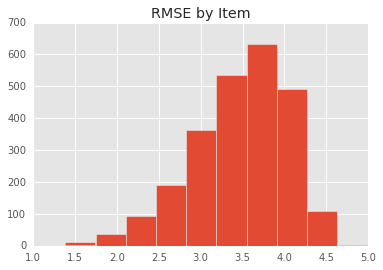

In [134]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.style.use('ggplot')

rmsevals = rmse_results['rmse_by_item']['rmse']
rmsevals = rmsevals[rmse_results['rmse_by_item']['count'] > 10]

plt.hist(rmsevals, bins = 10)
plt.title('RMSE by Item')
plt.show()

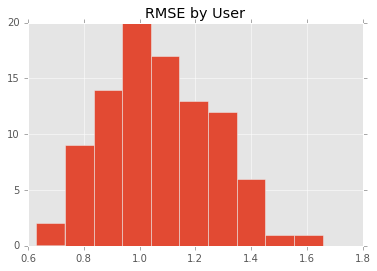

In [69]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.style.use('ggplot')

rmsevals = rmse_results['rmse_by_user']['rmse']
rmsevals = rmsevals[rmse_results['rmse_by_user']['count'] > 5]

plt.hist(rmsevals, bins = 10)
plt.title('RMSE by User')
plt.show()

### Precision & Recall 

In [37]:
rmse_results['precision_recall_by_user']

user_id,cutoff,precision,recall,count
11,1,0.0,0.0,30
11,2,0.5,0.0333333333333,30
11,3,0.333333333333,0.0333333333333,30
11,4,0.25,0.0333333333333,30
11,5,0.4,0.0666666666667,30
11,6,0.333333333333,0.0666666666667,30
11,7,0.285714285714,0.0666666666667,30
11,8,0.25,0.0666666666667,30
11,9,0.222222222222,0.0666666666667,30
11,10,0.2,0.0666666666667,30


In [38]:
import graphlab.aggregate as agg

agg_list = [agg.AVG('precision'),agg.STD('precision'),agg.AVG('recall'),agg.STD('recall')]

rmse_results['precision_recall_by_user'].groupby('cutoff',agg_list)

cutoff,Avg of precision,Stdv of precision,Avg of recall,Stdv of recall
36,0.200277777778,0.166216753846,0.27624805404,0.124967878935
2,0.38,0.36823905279,0.0365450061209,0.0533931217992
46,0.18,0.151896641806,0.316741228943,0.132507160652
31,0.211935483871,0.175577240341,0.254322648222,0.125537656118
26,0.226538461538,0.183239665869,0.233224851885,0.117834923208
8,0.29,0.246779253585,0.10114753941,0.0825916547687
5,0.326,0.270784046797,0.0769256156073,0.076594010678
16,0.25625,0.203004772111,0.173224036516,0.100463877923
41,0.191463414634,0.159131155242,0.300390439691,0.128063510805
4,0.34,0.292660212533,0.0652058637624,0.0734827094785


[Back to Top](#TOC)

## 4.2 User-Item

In [136]:
user_item = gl.recommender.ranking_factorization_recommender.create(train, 
                                  user_id = "user_id", 
                                  item_id = "title", 
                                  target = "rating")

rmse_results = user_item.evaluate(test)

Recsys training: model = ranking_factorization_recommender

Preparing data set.

Data has 800177 observations with 6040 users and 3677 items.

Data prepared in: 1.27397s

Training ranking_factorization_recommender for recommendations.

+--------------------------------+--------------------------------------------------+----------+

| Parameter                      | Description                                      | Value    |

+--------------------------------+--------------------------------------------------+----------+

| num_factors                    | Factor Dimension                                 | 32       |

| regularization                 | L2 Regularization on Factors                     | 1e-09    |

| solver                         | Solver used for training                         | adagrad  |

| linear_regularization          | L2 Regularization on Linear Coefficients         | 1e-09    |

| ranking_regularization         | Rank-based Regularization Weight                 | 0.25     |

| max_iterations                 | Maximum Number of Iterations                     | 25       |

+--------------------------------+--------------------------------------------------+----------+

Optimizing model using SGD; tuning step size.

Using 100022 / 800177 points for tuning the step size.

+---------+-------------------+------------------------------------------+

| Attempt | Initial Step Size | Estimated Objective Value                |

+---------+-------------------+------------------------------------------+

| 0       | 5.55556           | Not Viable                               |

| 1       | 1.38889           | Not Viable                               |

| 2       | 0.347222          | Not Viable                               |

| 3       | 0.0868056         | 0.92645                                  |

| 4       | 0.0434028         | 0.723878                                 |

| 5       | 0.0217014         | 1.46887                                  |

+---------+-------------------+------------------------------------------+

| Final   | 0.0434028         | 0.723878                                 |

+---------+-------------------+------------------------------------------+

Starting Optimization.

+---------+--------------+-------------------+-----------------------+-------------+

| Iter.   | Elapsed Time | Approx. Objective | Approx. Training RMSE | Step Size   |

+---------+--------------+-------------------+-----------------------+-------------+

| Initial | 95us         | 2.44595           | 1.11696               |             |

+---------+--------------+-------------------+-----------------------+-------------+

| 1       | 2.40s        | DIVERGED          | DIVERGED              | 0.0434028   |

| RESET   | 3.16s        | 2.4463            | 1.117                 |             |

| 1       | 5.01s        | 1.75216           | 1.08099               | 0.0217014   |

| 2       | 6.80s        | 1.35801           | 0.976769              | 0.0217014   |

| 3       | 8.60s        | 1.33836           | 0.996168              | 0.0217014   |

| 4       | 10.22s       | 1.39974           | 1.0326                | 0.0217014   |

| 5       | 11.80s       | 1.35495           | 1.02325               | 0.0217014   |

| 6       | 13.36s       | 1.32318           | 1.01731               | 0.0217014   |

| 7       | 14.89s       | 1.28717           | 1.00637               | 0.0217014   |

| 8       | 16.36s       | 1.26941           | 1.00217               | 0.0217014   |

| 9       | 17.85s       | 1.24433           | 0.993703              | 0.0217014   |

| 10      | 19.23s       | 1.25311           | 0.99852               | 0.0217014   |

| 11      | 20.59s       | 1.22235           | 0.986533              | 0.0217014   |

| 12      | 22.09s       | 1.21701           | 0.984777              | 0.0217014   |

| 13      | 23.63s       | 1.20351           | 0.980044              | 0.0217014   |

| 14      | 25.18s       | 1.19516           | 0.977334              | 0.0217014   |

| 15      | 26.65s       | 1.18604           | 0.974102              | 0.0217014   |

| 16      | 28.13s       | 1.18885           | 0.976827              | 0.0217014   |

| 17      | 29.53s       | 1.16565           | 0.965818              | 0.0217014   |

| 18      | 30.92s       | 1.16858           | 0.966914              | 0.0217014   |

| 19      | 32.40s       | 1.15199           | 0.960259              | 0.0217014   |

| 20      | 33.78s       | 1.15421           | 0.962962              | 0.0217014   |

| 21      | 35.10s       | 1.1423            | 0.957522              | 0.0217014   |

| 22      | 36.76s       | 1.13213           | 0.953483              | 0.0217014   |

| 23      | 38.21s       | 1.13219           | 0.954238              | 0.0217014   |

| 24      | 39.57s       | 1.11879           | 0.948584              | 0.0217014   |

| 25      | 40.98s       | 1.1134            | 0.946701              | 0.0217014   |

+---------+--------------+-------------------+-----------------------+-------------+

Optimization Complete: Maximum number of passes through the data reached.

Computing final objective value and training RMSE.

Final objective value: 1.09663

Final training RMSE: 0.937989

recommendations finished on 1000/6037 queries. users per second: 5686.86

recommendations finished on 2000/6037 queries. users per second: 5807.2

recommendations finished on 3000/6037 queries. users per second: 5903.63

recommendations finished on 4000/6037 queries. users per second: 5955.05

recommendations finished on 5000/6037 queries. users per second: 5990.03

recommendations finished on 6000/6037 queries. users per second: 5912.77


Precision and recall summary statistics by cutoff
+--------+-----------------+------------------+
| cutoff |  mean_precision |   mean_recall    |
+--------+-----------------+------------------+
|   1    |  0.115620341229 | 0.00395175487979 |
|   2    |  0.109325824085 | 0.00720194420416 |
|   3    |  0.103307382254 | 0.00993475861744 |
|   4    |  0.100588040417 |  0.012766008109  |
|   5    | 0.0973662415107 | 0.0153614683872  |
|   6    | 0.0951355529789 | 0.0180561728147  |
|   7    | 0.0928322960789 | 0.0205809938671  |
|   8    |  0.090359450058 | 0.0229492957761  |
|   9    | 0.0885097454586 | 0.0255601591297  |
|   10   | 0.0864667881398 | 0.0277278560888  |
+--------+-----------------+------------------+
[10 rows x 3 columns]

('\nOverall RMSE: ', 1.0600954257239266)

Per User RMSE (best)
+---------+-------+----------------+
| user_id | count |      rmse      |
+---------+-------+----------------+
|   373   |   1   | 0.127437317788 |
+---------+-------+----------------+
[1 row

In [137]:
rmse_results['precision_recall_by_user'].groupby('cutoff',[agg.AVG('precision'),agg.STD('precision'),agg.AVG('recall'),agg.STD('recall')])

cutoff,Avg of precision,Stdv of precision,Avg of recall,Stdv of recall
36,0.0694375425616,0.0919550600307,0.0813871833527,0.0933468625418
2,0.109325824085,0.240039253355,0.00720194420416,0.0243254379396
46,0.0659771985798,0.0849361371357,0.0990916485079,0.102760837876
31,0.0711953704842,0.0960718199412,0.0714448486586,0.0872754011638
26,0.0739223506326,0.101338904683,0.0626773685444,0.0807455795319
8,0.090359450058,0.148003202062,0.0229492957761,0.0463515463475
5,0.0973662415107,0.174395533468,0.0153614683872,0.0367337795136
16,0.0798823919165,0.116795400432,0.041691649143,0.0648863178078
41,0.0674499125313,0.0880359565851,0.0903135399254,0.0982406321046
4,0.100588040417,0.188377909926,0.012766008109,0.0327284811901


In [139]:
print rmse_results.viewkeys()
print rmse_results['rmse_by_item']

dict_keys(['rmse_by_user', 'precision_recall_overall', 'rmse_by_item', 'precision_recall_by_user', 'rmse_overall'])
+-------------------------------+-------+----------------+
|             title             | count |      rmse      |
+-------------------------------+-------+----------------+
|    Parent Trap, The (1998)    |   54  | 0.921548548681 |
|        Sneakers (1992)        |  220  |  0.8547413354  |
|  Man from Laramie, The (1955) |   5   | 1.56934482819  |
| Much Ado About Nothing (1993) |  132  | 0.955812859708 |
|          X-Men (2000)         |  306  | 0.977373415089 |
|         Psycho (1998)         |   53  |  1.1323777249  |
| Black Sabbath (Tre Volti D... |   2   | 1.61740222095  |
|  Boondock Saints, The (1999)  |   19  | 2.07716212832  |
|     Drop Dead Fred (1991)     |   60  | 0.965476862456 |
| Phantasm III: Lord of the ... |   14  | 1.60811593485  |
+-------------------------------+-------+----------------+
[3463 rows x 3 columns]
Note: Only the head of the SFrame 

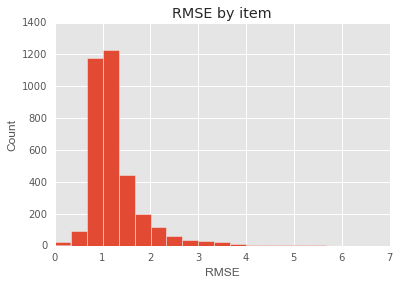

In [140]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.style.use('ggplot')
rmsevals=rmse_results['rmse_by_item']['rmse']
plt.hist(rmsevals, bins=20)
plt.xlabel('RMSE')
plt.ylabel('Count')
plt.title('RMSE by item')
plt.show()

[Back to Top](#TOC)

## 4.3 Popularity

In [148]:
gl.canvas.set_target('ipynb')

pop = gl.recommender.popularity_recommender.create(train, 
                                  user_id = "user_id", 
                                  item_id = "title", 
                                  target = "rating")
rmse_results = pop.evaluate(test)

Recsys training: model = popularity

Warning: Ignoring columns movie_id, timestamp, gender, age, occupation, zip, genres;

To use these columns in scoring predictions, use a model that allows the use of additional features.

Preparing data set.

Data has 800177 observations with 6040 users and 3677 items.

Data prepared in: 0.51577s

800177 observations to process; with 3677 unique items.

recommendations finished on 1000/6037 queries. users per second: 29382.4

recommendations finished on 2000/6037 queries. users per second: 33915

recommendations finished on 3000/6037 queries. users per second: 32486.9

recommendations finished on 4000/6037 queries. users per second: 32382.1

recommendations finished on 5000/6037 queries. users per second: 32690.8

recommendations finished on 6000/6037 queries. users per second: 30305


Precision and recall summary statistics by cutoff
+--------+-------------------+-------------------+
| cutoff |   mean_precision  |    mean_recall    |
+--------+-------------------+-------------------+
|   1    | 0.000165645188007 | 1.32516150406e-06 |
|   2    | 8.28225940036e-05 | 1.32516150406e-06 |
|   3    | 5.52150626691e-05 | 1.32516150406e-06 |
|   4    | 8.28225940036e-05 | 2.49887597908e-05 |
|   5    | 6.62580752029e-05 | 2.49887597908e-05 |
|   6    | 8.28225940036e-05 | 2.70088230592e-05 |
|   7    |  9.4654393147e-05 |  6.8420120061e-05 |
|   8    | 8.28225940036e-05 |  6.8420120061e-05 |
|   9    | 7.36200835588e-05 |  6.8420120061e-05 |
|   10   | 9.93871128044e-05 | 7.73414231584e-05 |
+--------+-------------------+-------------------+
[10 rows x 3 columns]

('\nOverall RMSE: ', 0.9798494105976326)

Per User RMSE (best)
+---------+-------+------------------+
| user_id | count |       rmse       |
+---------+-------+------------------+
|   2722  |   1   | 0.0013210039

In [149]:
print rmse_results.viewkeys()
print rmse_results['rmse_by_item']

dict_keys(['rmse_by_user', 'precision_recall_overall', 'rmse_by_item', 'precision_recall_by_user', 'rmse_overall'])
+-------------------------------+-------+----------------+
|             title             | count |      rmse      |
+-------------------------------+-------+----------------+
|    Parent Trap, The (1998)    |   54  | 1.02216612229  |
|        Sneakers (1992)        |  220  | 0.887926290058 |
|  Man from Laramie, The (1955) |   5   |      0.25      |
| Much Ado About Nothing (1993) |  132  | 0.896190582636 |
|          X-Men (2000)         |  306  | 0.867840063369 |
|         Psycho (1998)         |   53  | 1.17115487162  |
| Black Sabbath (Tre Volti D... |   2   | 0.553257790569 |
|  Boondock Saints, The (1999)  |   19  | 1.38044578368  |
|     Drop Dead Fred (1991)     |   60  | 1.04142571413  |
| Phantasm III: Lord of the ... |   14  | 1.11803398875  |
+-------------------------------+-------+----------------+
[3463 rows x 3 columns]
Note: Only the head of the SFrame 

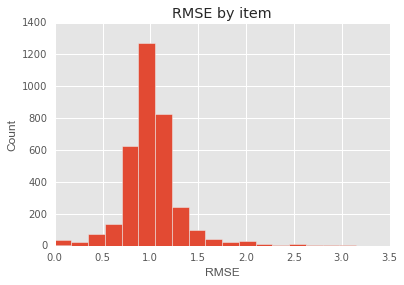

In [150]:
plt.style.use('ggplot')
rmsevals=rmse_results['rmse_by_item']['rmse']
plt.hist(rmsevals, bins=20)
plt.xlabel('RMSE')
plt.ylabel('Count')
plt.title('RMSE by item')
plt.show()

In [151]:
rmse_results['rmse_by_user']

user_id,count,rmse
5288,8,1.16842395273
3143,36,0.704377688838
5684,95,1.04962629414
2779,33,0.753618858634
118,56,0.7682191787
3988,37,0.855027069125
5783,8,1.63486378514
2847,75,1.31656852955
5499,12,1.04231557553
5531,24,0.938545219048


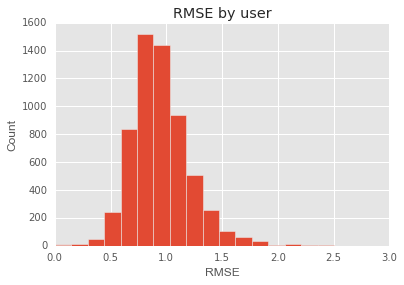

In [152]:
plt.style.use('ggplot')
rmsevals=rmse_results['rmse_by_user']['rmse']
plt.hist(rmsevals, bins=20)
plt.xlabel('RMSE')
plt.ylabel('Count')
plt.title('RMSE by user')
plt.show()

[Back to Top](#TOC)

## 4.4 Tuned Parameters

In [141]:
tuned = gl.recommender.ranking_factorization_recommender.create(train, 
                                  user_id = "user_id", 
                                  item_id = "title", 
                                  target = "rating",
                                  num_factors = 16,                 # override the default value
                                  regularization = 0.01,           # override the default value
                                  linear_regularization = 0.001)   # override the default value

rmse_results = tuned.evaluate(test)

Recsys training: model = ranking_factorization_recommender

Preparing data set.

Data has 800177 observations with 6040 users and 3677 items.

Data prepared in: 1.22614s

Training ranking_factorization_recommender for recommendations.

+--------------------------------+--------------------------------------------------+----------+

| Parameter                      | Description                                      | Value    |

+--------------------------------+--------------------------------------------------+----------+

| num_factors                    | Factor Dimension                                 | 16       |

| regularization                 | L2 Regularization on Factors                     | 0.01     |

| solver                         | Solver used for training                         | adagrad  |

| linear_regularization          | L2 Regularization on Linear Coefficients         | 0.001    |

| ranking_regularization         | Rank-based Regularization Weight                 | 0.25     |

| max_iterations                 | Maximum Number of Iterations                     | 25       |

+--------------------------------+--------------------------------------------------+----------+

Optimizing model using SGD; tuning step size.

Using 100022 / 800177 points for tuning the step size.

+---------+-------------------+------------------------------------------+

| Attempt | Initial Step Size | Estimated Objective Value                |

+---------+-------------------+------------------------------------------+

| 0       | 0.00920788        | 2.04109                                  |

| 1       | 0.00460394        | 2.08087                                  |

| 2       | 0.00230197        | 2.12445                                  |

| 3       | 0.00115098        | 2.16827                                  |

+---------+-------------------+------------------------------------------+

| Final   | 0.00920788        | 2.04109                                  |

+---------+-------------------+------------------------------------------+

Starting Optimization.

+---------+--------------+-------------------+-----------------------+-------------+

| Iter.   | Elapsed Time | Approx. Objective | Approx. Training RMSE | Step Size   |

+---------+--------------+-------------------+-----------------------+-------------+

| Initial | 76us         | 2.446             | 1.11695               |             |

+---------+--------------+-------------------+-----------------------+-------------+

| 1       | 1.50s        | 2.14202           | 1.10985               | 0.00920788  |

| 2       | 2.94s        | 2.1083            | 1.13488               | 0.00920788  |

| 3       | 4.34s        | 2.04254           | 1.11514               | 0.00920788  |

| 4       | 5.77s        | 2.0179            | 1.09882               | 0.00920788  |

| 5       | 7.23s        | 2.00611           | 1.08928               | 0.00920788  |

| 6       | 11.62s       | 1.99985           | 1.08422               | 0.00920788  |

| 7       | 12.96s       | 1.99639           | 1.07819               | 0.00920788  |

| 8       | 14.36s       | 1.99457           | 1.0759                | 0.00920788  |

| 9       | 15.77s       | 1.99324           | 1.07303               | 0.00920788  |

| 10      | 17.22s       | 1.99252           | 1.0707                | 0.00920788  |

| 11      | 18.72s       | 1.99238           | 1.06849               | 0.00920788  |

| 12      | 20.20s       | 1.99249           | 1.0678                | 0.00920788  |

| 13      | 21.52s       | 1.99212           | 1.06644               | 0.00920788  |

| 14      | 22.81s       | 1.99245           | 1.06517               | 0.00920788  |

| 15      | 24.14s       | 1.99268           | 1.06443               | 0.00920788  |

| 16      | 25.52s       | 1.99288           | 1.06367               | 0.00920788  |

| 17      | 26.85s       | 1.99287           | 1.06261               | 0.00920788  |

| 18      | 28.17s       | 1.99325           | 1.06242               | 0.00920788  |

| 19      | 29.53s       | 1.99327           | 1.06156               | 0.00920788  |

| 20      | 30.90s       | 1.99332           | 1.06218               | 0.00920788  |

| 21      | 32.25s       | 1.99398           | 1.06026               | 0.00920788  |

| 22      | 33.58s       | 1.99397           | 1.06093               | 0.00920788  |

| 23      | 34.89s       | 1.99407           | 1.06011               | 0.00920788  |

| 24      | 36.20s       | 1.9942            | 1.05987               | 0.00920788  |

| 25      | 37.52s       | 1.99424           | 1.05992               | 0.00920788  |

+---------+--------------+-------------------+-----------------------+-------------+

Optimization Complete: Maximum number of passes through the data reached.

Computing final objective value and training RMSE.

Final objective value: 2.01029

Final training RMSE: 1.05687

recommendations finished on 1000/6037 queries. users per second: 7507.51

recommendations finished on 2000/6037 queries. users per second: 7573

recommendations finished on 3000/6037 queries. users per second: 7590.57

recommendations finished on 4000/6037 queries. users per second: 7600.18

recommendations finished on 5000/6037 queries. users per second: 7595.48

recommendations finished on 6000/6037 queries. users per second: 7546.14


Precision and recall summary statistics by cutoff
+--------+----------------+------------------+
| cutoff | mean_precision |   mean_recall    |
+--------+----------------+------------------+
|   1    | 0.234719231406 | 0.00918385175136 |
|   2    | 0.205068742753 | 0.0147712382536  |
|   3    | 0.196676053227 |  0.020587220923  |
|   4    | 0.191692893821 | 0.0272190362335  |
|   5    | 0.188570482027 | 0.0338368097455  |
|   6    | 0.18762078295  | 0.0418914951166  |
|   7    | 0.184031803876 | 0.0479747915908  |
|   8    | 0.178234222296 |  0.053165050724  |
|   9    | 0.173044006405 | 0.0577342925973  |
|   10   | 0.169239688587 | 0.0629528662764  |
+--------+----------------+------------------+
[10 rows x 3 columns]

('\nOverall RMSE: ', 1.062040776320665)

Per User RMSE (best)
+---------+-------+-----------------+
| user_id | count |       rmse      |
+---------+-------+-----------------+
|   1190  |   1   | 0.0262226963412 |
+---------+-------+-----------------+
[1 rows x 3 colu

In [144]:
print rmse_results.viewkeys()
print rmse_results['rmse_by_item']

dict_keys(['rmse_by_user', 'precision_recall_overall', 'rmse_by_item', 'precision_recall_by_user', 'rmse_overall'])
+-------------------------------+-------+----------------+
|             title             | count |      rmse      |
+-------------------------------+-------+----------------+
|    Parent Trap, The (1998)    |   54  | 0.975727386839 |
|        Sneakers (1992)        |  220  | 0.942227855552 |
|  Man from Laramie, The (1955) |   5   | 0.702016846559 |
| Much Ado About Nothing (1993) |  132  | 1.15290278113  |
|          X-Men (2000)         |  306  | 1.02087179202  |
|         Psycho (1998)         |   53  | 1.10291216465  |
| Black Sabbath (Tre Volti D... |   2   | 0.902213868132 |
|  Boondock Saints, The (1999)  |   19  | 1.40181830033  |
|     Drop Dead Fred (1991)     |   60  | 1.00999418636  |
| Phantasm III: Lord of the ... |   14  | 1.04484528439  |
+-------------------------------+-------+----------------+
[3463 rows x 3 columns]
Note: Only the head of the SFrame 

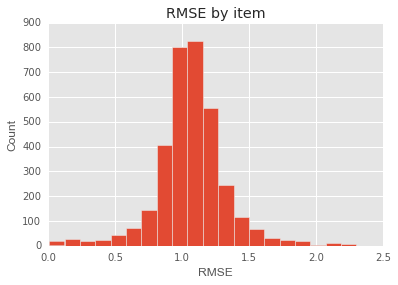

In [145]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.style.use('ggplot')
rmsevals=rmse_results['rmse_by_item']['rmse']
plt.hist(rmsevals, bins=20)
plt.xlabel('RMSE')
plt.ylabel('Count')
plt.title('RMSE by item')
plt.show()

In [153]:
comparisonstruct = gl.compare(test,[item_item, user_item, pop, tuned])

PROGRESS: Evaluate model M0


recommendations finished on 1000/6037 queries. users per second: 21965

recommendations finished on 2000/6037 queries. users per second: 23772.5

recommendations finished on 3000/6037 queries. users per second: 26180.1

recommendations finished on 4000/6037 queries. users per second: 27570.6

recommendations finished on 5000/6037 queries. users per second: 29043.1

recommendations finished on 6000/6037 queries. users per second: 29129.9


Precision and recall summary statistics by cutoff
+--------+----------------+-----------------+
| cutoff | mean_precision |   mean_recall   |
+--------+----------------+-----------------+
|   1    | 0.432002650323 | 0.0210899733997 |
|   2    | 0.405747888024 | 0.0384558886512 |
|   3    | 0.386505438684 | 0.0538605096694 |
|   4    | 0.367069736624 | 0.0664353018696 |
|   5    | 0.352426702004 | 0.0788688855294 |
|   6    | 0.338413119099 | 0.0893152404291 |
|   7    | 0.32693627393  | 0.0992976216165 |
|   8    | 0.317044889846 |  0.10872502924  |
|   9    | 0.308873060571 |  0.118185556364 |
|   10   | 0.299569322511 |  0.126349246049 |
+--------+----------------+-----------------+
[10 rows x 3 columns]

PROGRESS: Evaluate model M1


recommendations finished on 1000/6037 queries. users per second: 5685.6

recommendations finished on 2000/6037 queries. users per second: 5918.88

recommendations finished on 3000/6037 queries. users per second: 5977.64

recommendations finished on 4000/6037 queries. users per second: 5998.04

recommendations finished on 5000/6037 queries. users per second: 6039.33

recommendations finished on 6000/6037 queries. users per second: 5908.94


Precision and recall summary statistics by cutoff
+--------+-----------------+------------------+
| cutoff |  mean_precision |   mean_recall    |
+--------+-----------------+------------------+
|   1    |  0.115620341229 | 0.00395175487979 |
|   2    |  0.109325824085 | 0.00720194420416 |
|   3    |  0.103307382254 | 0.00993475861744 |
|   4    |  0.100588040417 |  0.012766008109  |
|   5    | 0.0973662415107 | 0.0153614683872  |
|   6    | 0.0951355529789 | 0.0180561728147  |
|   7    | 0.0928322960789 | 0.0205809938671  |
|   8    |  0.090359450058 | 0.0229492957761  |
|   9    | 0.0885097454586 | 0.0255601591297  |
|   10   | 0.0864667881398 | 0.0277278560888  |
+--------+-----------------+------------------+
[10 rows x 3 columns]

PROGRESS: Evaluate model M2


recommendations finished on 1000/6037 queries. users per second: 26837.7

recommendations finished on 2000/6037 queries. users per second: 27768.9

recommendations finished on 3000/6037 queries. users per second: 28224.9

recommendations finished on 4000/6037 queries. users per second: 28522.1

recommendations finished on 5000/6037 queries. users per second: 29670.2

recommendations finished on 6000/6037 queries. users per second: 29130.5


Precision and recall summary statistics by cutoff
+--------+-------------------+-------------------+
| cutoff |   mean_precision  |    mean_recall    |
+--------+-------------------+-------------------+
|   1    | 0.000165645188007 | 1.32516150406e-06 |
|   2    | 8.28225940036e-05 | 1.32516150406e-06 |
|   3    | 0.000110430125338 | 2.49887597908e-05 |
|   4    | 8.28225940036e-05 | 2.49887597908e-05 |
|   5    | 6.62580752029e-05 | 2.49887597908e-05 |
|   6    | 5.52150626691e-05 | 2.49887597908e-05 |
|   7    | 4.73271965735e-05 | 2.49887597908e-05 |
|   8    | 8.28225940036e-05 |  6.8420120061e-05 |
|   9    | 7.36200835588e-05 |  6.8420120061e-05 |
|   10   | 9.93871128044e-05 | 7.73414231584e-05 |
+--------+-------------------+-------------------+
[10 rows x 3 columns]

PROGRESS: Evaluate model M3


recommendations finished on 1000/6037 queries. users per second: 6960.06

recommendations finished on 2000/6037 queries. users per second: 7253.87

recommendations finished on 3000/6037 queries. users per second: 7415.85

recommendations finished on 4000/6037 queries. users per second: 7429.61

recommendations finished on 5000/6037 queries. users per second: 7407.4

recommendations finished on 6000/6037 queries. users per second: 7273.12


Precision and recall summary statistics by cutoff
+--------+----------------+------------------+
| cutoff | mean_precision |   mean_recall    |
+--------+----------------+------------------+
|   1    | 0.234719231406 | 0.00918385175136 |
|   2    | 0.205068742753 | 0.0147712382536  |
|   3    | 0.196676053227 |  0.020587220923  |
|   4    | 0.191692893821 | 0.0272190362335  |
|   5    | 0.188570482027 | 0.0338368097455  |
|   6    | 0.18762078295  | 0.0418914951166  |
|   7    | 0.184031803876 | 0.0479747915908  |
|   8    | 0.178234222296 |  0.053165050724  |
|   9    | 0.173044006405 | 0.0577342925973  |
|   10   | 0.169239688587 | 0.0629528662764  |
+--------+----------------+------------------+
[10 rows x 3 columns]

Model compare metric: precision_recall


In [154]:
gl.show_comparison(comparisonstruct,[item_item, user_item, pop, tuned])

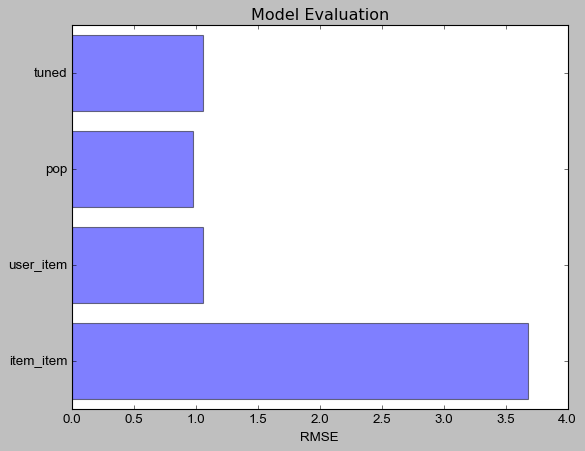

In [162]:
import matplotlib.pyplot as plt; plt.rcdefaults()
 
objects = ('item_item', 'user_item', 'pop', 'tuned')
y_pos = np.arange(len(objects))
performance = [3.6773714442306926, 1.0600954257239266, 0.9798494105976326, 1.062040776320665]
 
plt.barh(y_pos, performance, align='center', alpha=0.5)
plt.yticks(y_pos, objects)
plt.xlabel('RMSE')
plt.title('Model Evaluation')
 
plt.show()

[Back to Top](#TOC)

## 4.5 Grid Search 

In [45]:
params = {'user_id': 'user_id', 
          'item_id': 'title', 
          'target': 'rating',
          'num_factors': [8, 12, 16, 24, 32], 
          'regularization':[0.001] ,
          'linear_regularization': [0.001]}

job = gl.model_parameter_search.create( (train,test),
        gl.recommender.ranking_factorization_recommender.create,
        params,
        max_models = 5,
        environment = None)

[INFO] graphlab.deploy.job: Validating job.
[INFO] graphlab.deploy.job: Creating a LocalAsync environment called 'async'.
[INFO] graphlab.deploy.map_job: Validation complete. Job: 'Model-Parameter-Search-Aug-09-2017-23-07-1800000' ready for execution
[INFO] graphlab.deploy.map_job: Job: 'Model-Parameter-Search-Aug-09-2017-23-07-1800000' scheduled.
[INFO] graphlab.deploy.job: Validating job.
[INFO] graphlab.deploy.map_job: A job with name 'Model-Parameter-Search-Aug-09-2017-23-07-1800000' already exists. Renaming the job to 'Model-Parameter-Search-Aug-09-2017-23-07-1800000-f1e09'.
[INFO] graphlab.deploy.map_job: Validation complete. Job: 'Model-Parameter-Search-Aug-09-2017-23-07-1800000-f1e09' ready for execution
[INFO] graphlab.deploy.map_job: Job: 'Model-Parameter-Search-Aug-09-2017-23-07-1800000-f1e09' scheduled.


In [49]:
job.get_status()

{'Canceled': 0, 'Completed': 5, 'Failed': 0, 'Pending': 0, 'Running': 0}

In [48]:
job_result = job.get_results()

job_result.head()

model_id,item_id,linear_regularization,max_iterations,num_factors,num_sampled_negative_examples ...,ranking_regularization
1,title,0.001,50,12,8,0.5
0,title,0.001,25,32,4,0.25
3,title,0.001,25,8,8,0.5
2,title,0.001,50,16,4,0.5
4,title,0.001,25,12,4,0.5
regularization,target,user_id,training_precision@5,training_recall@5,training_rmse,validation_precision@5
0.001,rating,user_id,0.451390728477,0.0210706980023,1.03693392809,0.136
0.001,rating,user_id,0.444834437086,0.0204716712727,1.08117400197,0.172
0.001,rating,user_id,0.460099337748,0.0215576169584,1.07826416323,0.154
0.001,rating,user_id,0.450927152318,0.0210438105479,1.06122767649,0.152


In [50]:
bst_prms = job.get_best_params()
bst_prms

{'item_id': 'title',
 'linear_regularization': 0.001,
 'max_iterations': 50,
 'num_factors': 12,
 'num_sampled_negative_examples': 8,
 'ranking_regularization': 0.5,
 'regularization': 0.001,
 'target': 'rating',
 'user_id': 'user_id'}

In [51]:
models = job.get_models()
models

[Class                            : RankingFactorizationRecommender
 
 Schema
 ------
 User ID                          : user_id
 Item ID                          : title
 Target                           : rating
 Additional observation features  : 7
 User side features               : []
 Item side features               : []
 
 Statistics
 ----------
 Number of observations           : 997128
 Number of users                  : 6040
 Number of items                  : 3705
 
 Training summary
 ----------------
 Training time                    : 62.7761
 
 Model Parameters
 ----------------
 Model class                      : RankingFactorizationRecommender
 num_factors                      : 32
 binary_target                    : 0
 side_data_factorization          : 1
 solver                           : auto
 nmf                              : 0
 max_iterations                   : 25
 
 Regularization Settings
 -----------------------
 regularization                   : 0.001
 re

In [52]:
comparisonstruct = gl.compare(test,models)
gl.show_comparison(comparisonstruct,models)

PROGRESS: Evaluate model M0

Precision and recall summary statistics by cutoff
+--------+----------------+------------------+
| cutoff | mean_precision |   mean_recall    |
+--------+----------------+------------------+
|   1    |      0.18      | 0.00595617466299 |
|   2    |      0.18      | 0.0118538111104  |
|   3    | 0.196666666667 | 0.0216574855281  |
|   4    |     0.1825     | 0.0257307618318  |
|   5    |     0.172      | 0.0292013486135  |
|   6    |     0.165      | 0.0321354184941  |
|   7    | 0.161428571429 | 0.0367856109295  |
|   8    |    0.15875     |  0.041730247363  |
|   9    | 0.162222222222 | 0.0492828703296  |
|   10   |     0.158      | 0.0543654122912  |
+--------+----------------+------------------+
[10 rows x 3 columns]

PROGRESS: Evaluate model M1

Precision and recall summary statistics by cutoff
+--------+----------------+------------------+
| cutoff | mean_precision |   mean_recall    |
+--------+----------------+------------------+
|   1    |      0.22

[Back to Top](#TOC)

# 5. Deployment

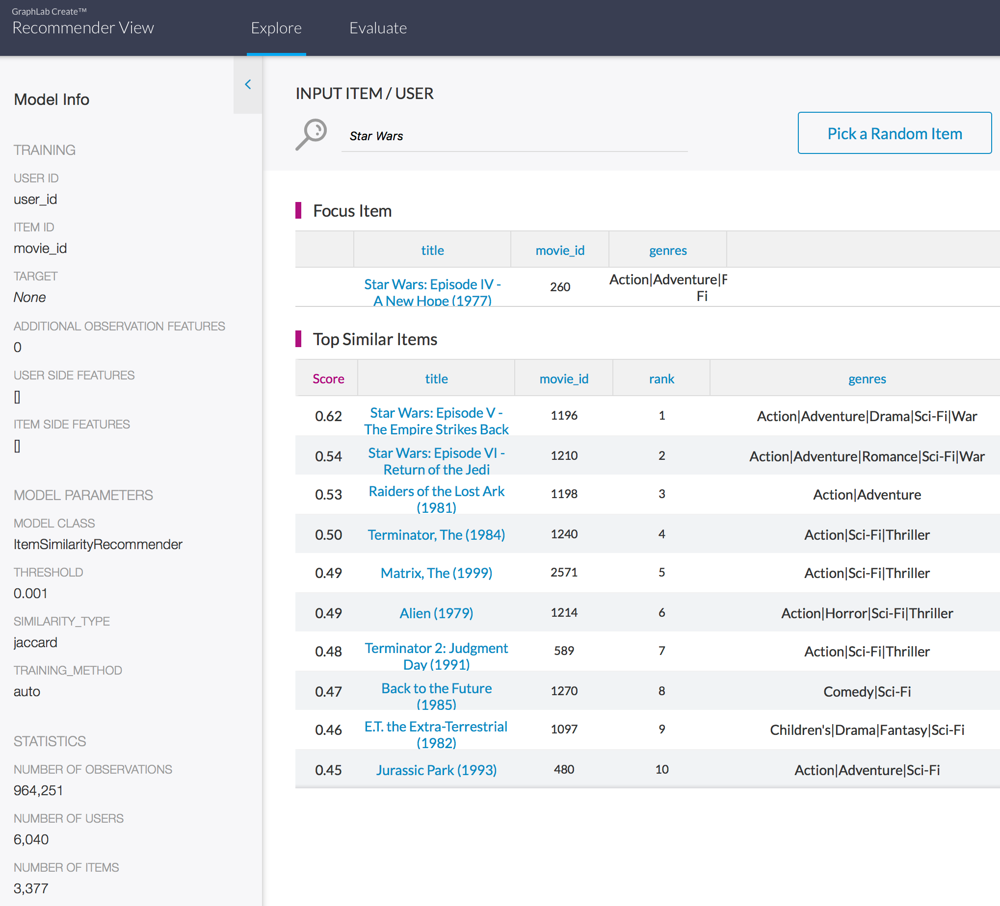

In [158]:
from IPython.display import Image
Image("glRecommenderView.png")

[Back to Top](#TOC)

# 6. References

- http://grouplens.org/datasets/movielens/1m/

- Wes McKinney, *Python for Data Analysis: Data Wrangling with Pandas, NumPy, and IPython*, O'Reilly

- Eric Larsson, *13. Recommendation Systems: Collaborative Filtering in Turi (formerly Dato, Formerly GraphLab)*, GitHub